In [1]:
%load_ext autoreload

In [2]:
%autoreload 2

In [3]:
%cd ..

/Users/kristophermiltiadou/Documents/UniWork/Cambridge/Thesis/CODE/iREC


In [4]:
# load modules
import torch
import torch.distributions as D
import pickle as pkl
import matplotlib.pyplot as plt
from models.SimpleBayesianLinRegressor import BayesLinRegressor
from rec.utils import compute_variational_posterior

import math
%config InlineBackend.figure_format='retina'

In [5]:
%matplotlib inline

In [6]:
plt.rcParams.update({'font.weight': 'normal'})
plt.rcParams.update({'font.size': 16})
plt.rcParams.update({'lines.linewidth' : 2})

In [7]:
torch.set_default_tensor_type(torch.DoubleTensor)

In [8]:
#lets compress some samples
#### sample weights with compression algorithm
from tqdm.notebook import trange
from rec.beamsearch.Coders.Encoder_Empirical import Encoder
from rec.beamsearch.distributions.CodingSampler import CodingSampler
from rec.beamsearch.distributions.EmpiricalMixturePosterior import EmpiricalMixturePosterior
from rec.beamsearch.samplers.GreedySampling_BNNs import GreedySampler
from models.BNNs.BNN_for_HMC import BNN_for_HMC
import pyro.distributions as dist

In [9]:
from models.BNNs.DeterministicNN import Deterministic_NN

In [10]:
# gen data
# create toy dataset
torch.set_default_tensor_type(torch.DoubleTensor)
torch.manual_seed(20)
x = torch.cat([torch.Tensor(75).uniform_(-5, -2).sort()[0].reshape(-1, 1),
               torch.Tensor(50).uniform_(2, 5).sort()[0].reshape(-1, 1)])
i = 30
x_data = torch.cat([x[0:i - 15], x[i + 14:]])

# generate some data
alpha, beta, num_nodes = 1., 100., 2

# generate some data
data_generator_model = Deterministic_NN(alpha=alpha, beta=beta, num_nodes=num_nodes)
sampled_weights = data_generator_model.sample_weights_from_prior()
data_generator_model.make_weights_from_sample(sampled_weights)
y_data = data_generator_model(x_data).detach() + (
            1 / data_generator_model.likelihood_beta ** 0.5) * torch.randn_like(
    data_generator_model(x_data).detach())

x_test = torch.Tensor(200).uniform_(-10., 10.).sort()[0]
y_test = data_generator_model(x_test).detach() + (
            1 / data_generator_model.likelihood_beta ** 0.5) * torch.randn_like(
    data_generator_model(x_test).detach()).sort()[0]

In [11]:
alpha, beta, num_nodes = 1., 100., 2
ELBO_BETA = 1.

In [12]:
hmc_samples = pkl.load(open(f'PickledStuff/BNN_BETA_RESULTS/EMP/HMC_beta_{ELBO_BETA}.pkl', 'rb'))
kde_target = pkl.load(open(f'PickledStuff/BNN_BETA_RESULTS/KDE/HMC_KDE_target_beta_{ELBO_BETA}.pkl', 'rb'))
kl_q_p = pkl.load(open(f'PickledStuff/BNN_BETA_RESULTS/EMP/hmc_kl_beta_{ELBO_BETA}.pkl', 'rb'))

# Empirical Trajectory

In [13]:
coding_sampler = CodingSampler
auxiliary_posterior = EmpiricalMixturePosterior
selection_sampler = GreedySampler

In [14]:
def encode_sample_emp(omega=5, epsilon=0.,
                  n_empirical_samples=10, seed=0, beamwidth=1, optimising_vars=False, aux_vars=None, dont_run=False,
                     initial_seed=1):
    
    dummy_model = BNN_for_HMC(alpha=alpha, beta=beta, num_nodes=num_nodes)
    encoder = Encoder(dummy_model,
                     x_data,
                     y_data,
                     hmc_samples,
                     initial_seed,
                     coding_sampler,
                     selection_sampler,
                     auxiliary_posterior,
                     omega,
                     beamwidth,
                     epsilon=epsilon,
                     prior_var=1./alpha,
                     total_kl=kl_q_p)
    
    if aux_vars is not None:
        encoder.auxiliary_posterior.coding_sampler.auxiliary_vars = aux_vars
    
    if dont_run:
        return encoder
    else:
        return encoder, *encoder.run_encoder()

In [15]:
eps = 0.2
beamwidth = 1

In [16]:
enc, z, idx = encode_sample_emp(epsilon=eps, beamwidth=1)

In [29]:
def plot_traj(hmc_samples, aux_samples):
    samples = hmc_samples
    dim = hmc_samples.shape[-1]
    running_sum = torch.cumsum(aux_samples, dim=0)
    final_sample = running_sum[-1]
    f, ax = plt.subplots(dim, dim, figsize=(3*dim, 3*dim), sharex=True, sharey=True)
    for i in range(dim):
        for j in range(dim):
            if i!=j:
                ax[i, j].plot(samples[:, i], samples[:, j], 'x', alpha=0.5)
                ax[i, j].plot(running_sum[:, i], running_sum[:, j], 'o-')
                ax[i, j].plot(final_sample[i], final_sample[j], 'ko')
            if i == dim - 1:
                ax[i, j].set_xlabel(f'$\mathbf{{w}}_{{{j+1}}}$')
            if j == 0:
                ax[i, j].set_ylabel(f'$\mathbf{{w}}_{{{i+1}}}$')
    f.tight_layout()

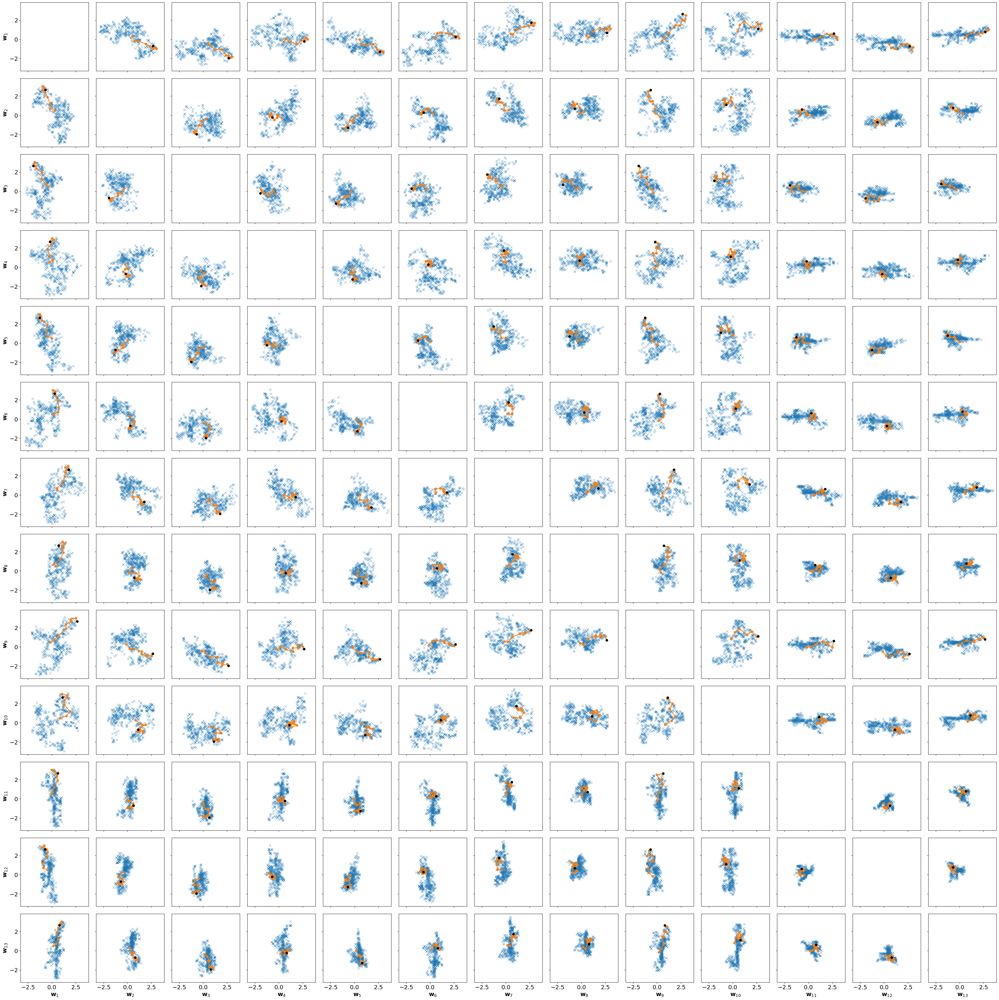

In [31]:
plot_traj(hmc_samples, enc.selected_samples[0])
plt.savefig(f"Figures/Thesis/emp_BNN_eps{eps}_traj.pdf", bbox_inches='tight')

# KDE

In [32]:
from rec.beamsearch.distributions.CodingSampler import CodingSampler
from rec.beamsearch.distributions.KDEPosterior import KDEPosterior
from rec.beamsearch.samplers.GreedySampling import GreedySampler
from rec.beamsearch.Coders.Encoder_KDE import EncoderKDE

In [33]:
def encode_sample_kde(omega=5, epsilon=0.,
                  n_empirical_samples=10, seed=0, beamwidth=1, optimising_vars=False, aux_vars=None, dont_run=False,
                     initial_seed=1):
    
    dummy_model = BNN_for_HMC(alpha=alpha, beta=beta, num_nodes=num_nodes)
    encoder = EncoderKDE(kde_target,
                        initial_seed,
                        coding_sampler,
                        selection_sampler,
                        auxiliary_posterior,
                        omega,
                        epsilon=epsilon,
                        beamwidth=beamwidth,
                        prior_var=1./alpha)
    
    if aux_vars is not None:
        encoder.auxiliary_posterior.coding_sampler.auxiliary_vars = aux_vars
    
    if dont_run:
        return encoder
    else:
        return encoder, *encoder.run_encoder()

In [34]:
enc, z, idx = encode_sample_emp(epsilon=eps, beamwidth=1)

In [36]:
def plot_traj_kde(hmc_samples, kde_target, aux_samples):
    samples = hmc_samples
    kde_samples = kde_target.sample((1000,))
    dim = hmc_samples.shape[-1]
    running_sum = torch.cumsum(aux_samples, dim=0)
    final_sample = running_sum[-1]
    f, ax = plt.subplots(dim, dim, figsize=(3*dim, 3*dim), sharex=True, sharey=True)
    for i in range(dim):
        for j in range(dim):
            if i!=j:
                ax[i, j].plot(kde_samples[:, i], kde_samples[:, j], 'x', alpha=0.5)
                #ax[i, j].plot(samples[:, i], samples[:, j], 'x', color='blue', alpha=0.5)
                ax[i, j].plot(running_sum[:, i], running_sum[:, j], 'o-')
                ax[i, j].plot(final_sample[i], final_sample[j], 'ko')
            if i == dim - 1:
                ax[i, j].set_xlabel(f'$\mathbf{{w}}_{{{j+1}}}$')
            if j == 0:
                ax[i, j].set_ylabel(f'$\mathbf{{w}}_{{{i+1}}}$')
    f.tight_layout()

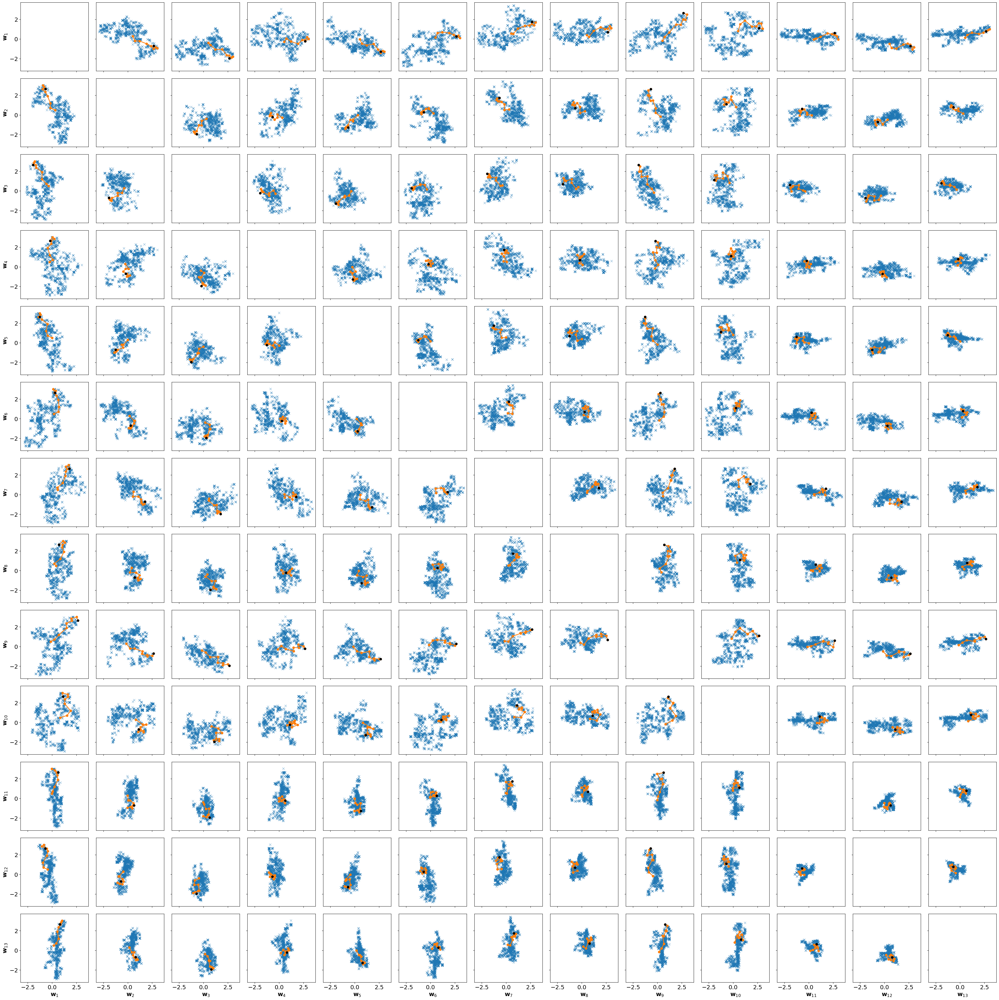

In [37]:
plot_traj_kde(hmc_samples, kde_target, enc.selected_samples[0])
plt.savefig(f"Figures/Thesis/kde_BNN_eps{eps}_traj.pdf", bbox_inches='tight')

# Variational Trajectories

In [38]:
ELBO_BETA = 0.05
target = pkl.load(open(f'PickledStuff/BNN_BETA_RESULTS/VAR/var_post_beta_{ELBO_BETA}.pkl', 'rb'))

In [39]:
from rec.beamsearch.distributions.VariationalPosterior import VariationalPosterior
from rec.beamsearch.Coders.Encoder_Variational import Encoder as Variational_Encoder

In [40]:
def encode_sample_var(target, omega=5, epsilon=0.,
                  n_empirical_samples=10, seed=0, beamwidth=1, optimising_vars=False, aux_vars=None, dont_run=False):
    
    target = compute_variational_posterior(target)
    encoder = Variational_Encoder(target,
                                  seed,
                                  CodingSampler,
                                  GreedySampler,
                                  VariationalPosterior,
                                  omega,
                                  epsilon=epsilon,
                                  beamwidth=beamwidth
                                  )
    if aux_vars is not None:
        encoder.auxiliary_posterior.coding_sampler.auxiliary_vars = aux_vars
    
    if dont_run:
        return encoder
    else:
        return encoder, *encoder.run_encoder()

In [41]:
def plot_traj(target, aux_samples, num_samples=1000):
    samples = target.sample((num_samples,))
    dim = target.mean.shape[-1]
    running_sum = torch.cumsum(aux_samples, dim=0)
    final_sample = running_sum[-1]
    f, ax = plt.subplots(dim, dim, figsize=(3*dim, 3*dim), sharex=True, sharey=True)
    for i in range(dim):
        for j in range(dim):
            if i!=j:
                ax[i, j].plot(samples[:, i], samples[:, j], 'x', alpha=0.5)
                ax[i, j].plot(running_sum[:, i], running_sum[:, j], 'o-')
                ax[i, j].plot(final_sample[i], final_sample[j], 'ko')
                
            if i == dim - 1:
                ax[i, j].set_xlabel(f'$\mathbf{{w}}_{{{j+1}}}$')
            if j == 0:
                ax[i, j].set_ylabel(f'$\mathbf{{w}}_{{{i+1}}}$')
    f.tight_layout()

In [42]:
enc, z, idx = encode_sample_var(target, epsilon=eps, beamwidth=1)

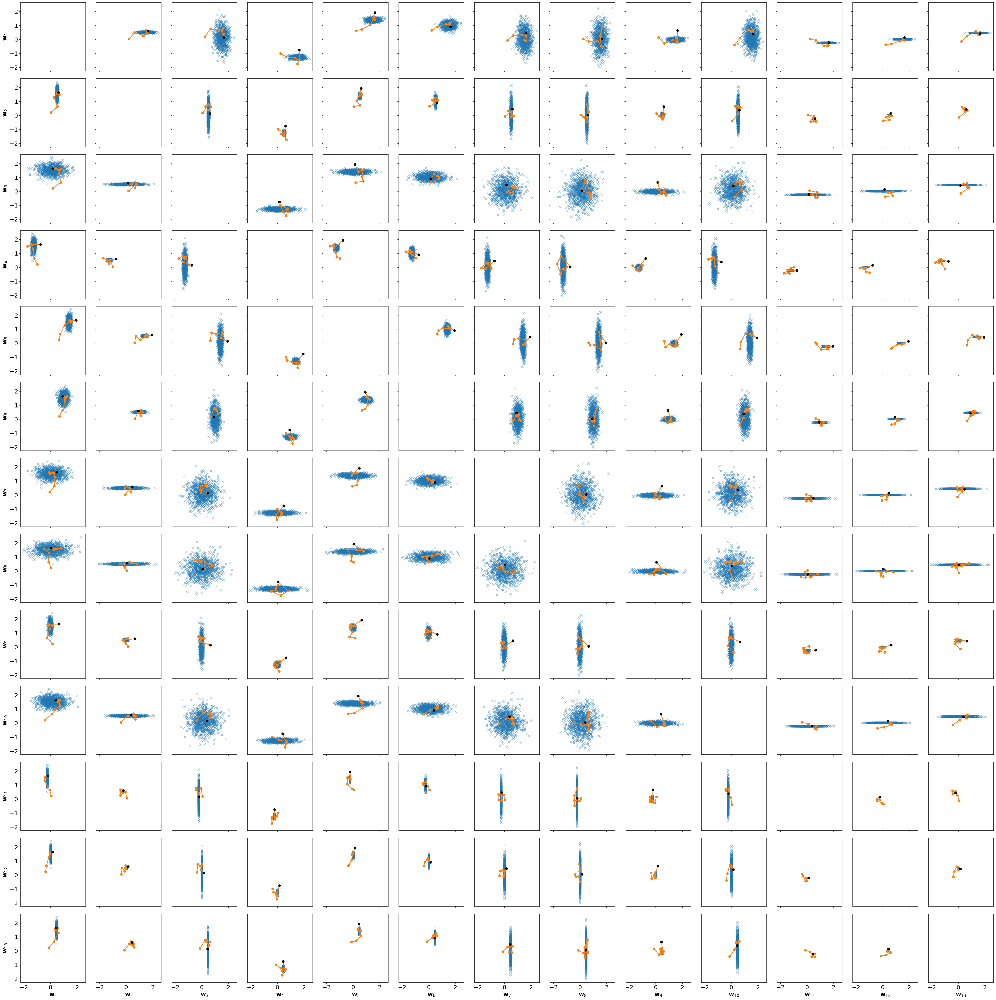

In [43]:
plot_traj(target, enc.selected_samples[0])
plt.savefig(f"Figures/Thesis/var_BNN_eps{eps}_traj.pdf", bbox_inches='tight')